In [2]:
import pandas as pd
import numpy as np
from pathlib import Path
import plotly.express as px
import seaborn as sns
import matplotlib.pyplot as plt

In [3]:
valuations = pd.read_csv(Path.cwd()/'archive-4/player_valuations.csv')
players = pd.read_csv(Path.cwd()/'archive-4/players.csv')
display(valuations, players)

,player_id,date,market_value_in_eur,current_club_id,player_club_domestic_competition_id
0,405973,2000-01-20,150000,3057.0,BE1
1,342216,2001-07-20,100000,1241.0,SC1
2,3132,2003-12-09,400000,126.0,TR1
3,6893,2003-12-15,900000,984.0,GB1
4,10,2004-10-04,7000000,398.0,IT1
...,...,...,...,...,...
464777,1073997,2024-01-08,150000,18.0,L1
464778,361508,2024-01-10,300000,39.0,L1
464779,705337,2024-01-10,125000,26459.0,UKR1
464780,800946,2024-01-10,1000000,79.0,L1


,player_id,first_name,last_name,name,last_season,current_club_id,player_code,country_of_birth,city_of_birth,country_of_citizenship,...,foot,height_in_cm,contract_expiration_date,agent_name,image_url,url,current_club_domestic_competition_id,current_club_name,market_value_in_eur,highest_market_value_in_eur
0,10,Miroslav,Klose,Miroslav Klose,2015,398,miroslav-klose,Poland,Opole,Germany,...,right,184.0,NaN,ASBW Sport Marketing,https://img.a.transfermarkt.technology/portrai...,https://www.transfermarkt.co.uk/miroslav-klose...,IT1,Società Sportiva Lazio S.p.A.,1000000.0,30000000.0
1,26,Roman,Weidenfeller,Roman Weidenfeller,2017,16,roman-weidenfeller,Germany,Diez,Germany,...,left,190.0,NaN,Neubauer 13 GmbH,https://img.a.transfermarkt.technology/portrai...,https://www.transfermarkt.co.uk/roman-weidenfe...,L1,Borussia Dortmund,750000.0,8000000.0
2,65,Dimitar,Berbatov,Dimitar Berbatov,2015,1091,dimitar-berbatov,Bulgaria,Blagoevgrad,Bulgaria,...,NaN,NaN,NaN,CSKA-AS-23 Ltd.,https://img.a.transfermarkt.technology/portrai...,https://www.transfermarkt.co.uk/dimitar-berbat...,GR1,Panthessalonikios Athlitikos Omilos Konstantin...,1000000.0,34500000.0
3,77,NaN,Lúcio,Lúcio,2012,506,lucio,Brazil,Brasília,Brazil,...,NaN,NaN,NaN,NaN,https://img.a.transfermarkt.technology/portrai...,https://www.transfermarkt.co.uk/lucio/profil/s...,IT1,Juventus Football Club,200000.0,24500000.0
4,80,Tom,Starke,Tom Starke,2017,27,tom-starke,East Germany (GDR),Freital,Germany,...,right,194.0,NaN,IFM,https://img.a.transfermarkt.technology/portrai...,https://www.transfermarkt.co.uk/tom-starke/pro...,L1,FC Bayern München,100000.0,3000000.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
30378,1166093,Georgios,Konstantakopoulos,Georgios Konstantakopoulos,2023,30120,georgios-konstantakopoulos,NaN,NaN,Greece,...,both,182.0,2026-06-30 00:00:00,NaN,https://img.a.transfermarkt.technology/portrai...,https://www.transfermarkt.co.uk/georgios-konst...,GR1,Athlitiki Enosi Kifisias,100000.0,100000.0
30379,1173042,Djibi,Seck,Djibi Seck,2023,601,djibi-seck,NaN,NaN,Senegal,...,NaN,NaN,2025-06-30 00:00:00,NaN,https://img.a.transfermarkt.technology/portrai...,https://www.transfermarkt.co.uk/djibi-seck/pro...,BE1,Koninklijke Voetbalclub Kortrijk,150000.0,150000.0
30380,1176345,Mahamadou,Nagida,Mahamadou Nagida,2023,273,mahamadou-nagida,Cameroon,Douala,Cameroon,...,left,176.0,2028-06-30 00:00:00,NaN,https://img.a.transfermarkt.technology/portrai...,https://www.transfermarkt.co.uk/mahamadou-nagi...,FR1,Stade Rennais Football Club,150000.0,150000.0
30381,1176866,Motez,Nourani,Motez Nourani,2023,3840,motez-nourani,Tunisia,Sousse,Tunisia,...,right,NaN,2026-06-30 00:00:00,PROhorizons Group,https://img.a.transfermarkt.technology/portrai...,https://www.transfermarkt.co.uk/motez-nourani/...,TR1,Adana Demirspor Kulübü,250000.0,250000.0


In [4]:
players.date_of_birth = pd.to_datetime(players.date_of_birth)
valuations.date = pd.to_datetime(valuations.date)

In [5]:
valuations = valuations.merge(players[['player_id', 'date_of_birth']], on='player_id')

In [6]:
valuations['age'] = (valuations.date - valuations.date_of_birth) / np.timedelta64(1, 'Y')
valuations = valuations[(valuations.age > 16) & (valuations.age < 40)]

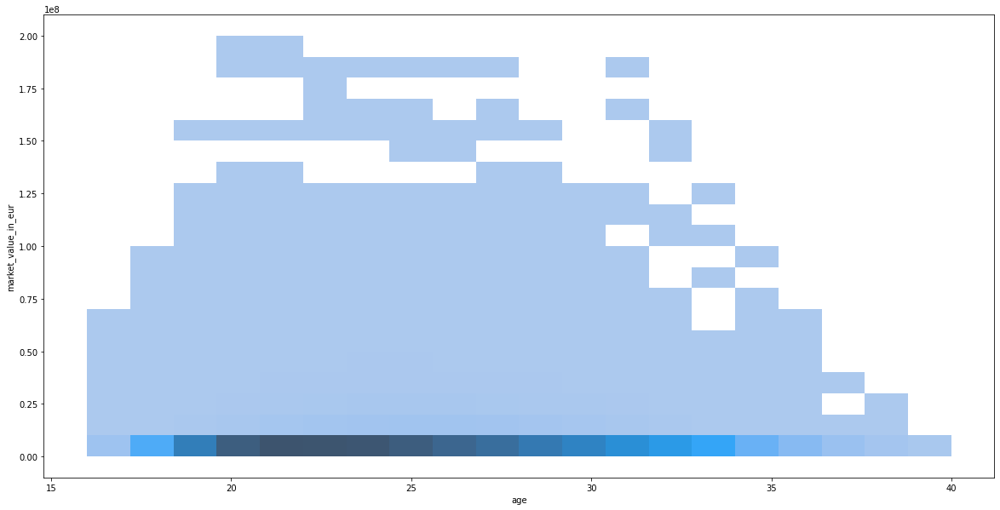

In [7]:
plt.figure(figsize=(20, 10))
sns.histplot(data=valuations, x='age', y='market_value_in_eur', bins=20, kde=True)
# sns.kdeplot(data=valuations, x='age', y='market_value_in_eur', )
plt.show()

In [9]:
px.scatter(data_frame=valuations, x='age', y='market_value_in_eur',trendline='lowess')